In [2]:
import requests
import pandas as pd
from pandas import json_normalize
import numpy as np
import json
#import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import folium
#from folium import Choropleth
from folium.plugins import HeatMap
import datetime
from plotly.offline import init_notebook_mode, plot, iplot
import plotly as py
init_notebook_mode(connected=True) 
import plotly.graph_objs as go

In [2]:
#store the link
url = 'https://earthquake.usgs.gov/fdsnws/event/1/query?format=geojson&starttime=2022-07-01&endtime=2022-07-31'

#check to see if we get a response from the API
r = requests.get(url)
r

<Response [200]>

In [10]:
# Use a loop to get a hundred years of earthquake data:

months = ["01","02","03","04","05","06","07","08","09","10","11","12"]
predata = []
for y in range(1920,1960):
    for m in months:
        x =requests.get(f'https://earthquake.usgs.gov/fdsnws/event/1/query?format=geojson&starttime={str(y)}-{m}-01&endtime={str(y)}-{m}-31')
        predata.append(x)

In [4]:
import pickle
pickle_out = open("1920-1960.pickle","wb")
pickle.dump(predata, pickle_out)
pickle_out.close()

In [9]:
hundred_yr_data[-1].json()

JSONDecodeError: [Errno Expecting value] Too Many Requests. Please contact gs-haz_dev_team_group@usgs.gov: 0

In [3]:
# Most of the data is contained in a dictionary within the properties column, we will extract the data using json_normalize. 

data = r.json()
d0 = json_normalize(data,'features')
d0.head()
df = pd.DataFrame(d0)
df.head()

,type,id,properties.mag,properties.place,properties.time,properties.updated,properties.tz,properties.url,properties.detail,properties.felt,...,properties.types,properties.nst,properties.dmin,properties.rms,properties.gap,properties.magType,properties.type,properties.title,geometry.type,geometry.coordinates
0,Feature,ak0229pcf7rl,2.60,"113 km E of Chignik, Alaska",1659225367215,1659225585732,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/fdsnws/event/1/que...,NaN,...,",origin,phase-data,",NaN,NaN,0.66,NaN,ml,earthquake,"M 2.6 - 113 km E of Chignik, Alaska",Point,"[-156.5634, 56.2988, 31.3]"
1,Feature,nc73764496,1.18,"11km ENE of Hidden Valley Lake, CA",1659224909800,1659249070805,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/fdsnws/event/1/que...,NaN,...,",nearby-cities,origin,phase-data,scitech-link,",19.0,0.03003,0.07,88.0,md,earthquake,"M 1.2 - 11km ENE of Hidden Valley Lake, CA",Point,"[-122.4426667, 38.8486667, 7.22]"
2,Feature,ci40072575,0.61,"10km SW of Searles Valley, CA",1659224285920,1659558550840,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/fdsnws/event/1/que...,NaN,...,",nearby-cities,origin,phase-data,scitech-link,",14.0,0.12360,0.14,163.0,ml,earthquake,"M 0.6 - 10km SW of Searles Valley, CA",Point,"[-117.4936667, 35.7076667, 10.68]"
3,Feature,av91650536,0.22,"41 km NE of Adak, Alaska",1659224154190,1659471266410,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/fdsnws/event/1/que...,NaN,...,",origin,phase-data,",4.0,NaN,0.27,311.0,ml,earthquake,"M 0.2 - 41 km NE of Adak, Alaska",Point,"[-176.178833333333, 52.1136666666667, 10.03]"
4,Feature,ci40072567,1.30,"11km ESE of Lake Isabella, CA",1659224149970,1659369063102,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/fdsnws/event/1/que...,NaN,...,",nearby-cities,origin,phase-data,scitech-link,",32.0,0.10920,0.16,60.0,ml,earthquake,"M 1.3 - 11km ESE of Lake Isabella, CA",Point,"[-118.3585, 35.5858333, 1.98]"


In [4]:
#We now need to extract the location data from the geometry.coordinates data.

df[['Longitude','Latitude','Depth']] = pd.DataFrame(df['geometry.coordinates'].tolist(),index= df.index)

In [5]:
column_names = ['Type','ID','mag','place','time','updated','tz','url','detail','felt','cdi','mmi','alert','status','tsunami','sig','net','code','ids','sources','types','nst','dmin','rms','gap','magType','type','title','geometry.type','geometry.coordinates','Longitude','Latitude','Depth'
]

In [6]:
df.set_axis(column_names, axis=1,inplace=True)

In [7]:
df['Time'] = pd.to_datetime(df['time'],
                      unit = 'ms')

In [9]:
df

,Type,ID,mag,place,time,updated,tz,url,detail,felt,...,gap,magType,type,title,geometry.type,geometry.coordinates,Longitude,Latitude,Depth,Time
0,Feature,ak0229pcf7rl,2.60,"113 km E of Chignik, Alaska",1659225367215,1659225585732,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/fdsnws/event/1/que...,NaN,...,NaN,ml,earthquake,"M 2.6 - 113 km E of Chignik, Alaska",Point,"[-156.5634, 56.2988, 31.3]",-156.563400,56.298800,31.30,2022-07-30 23:56:07.215
1,Feature,nc73764496,1.18,"11km ENE of Hidden Valley Lake, CA",1659224909800,1659249070805,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/fdsnws/event/1/que...,NaN,...,88.0,md,earthquake,"M 1.2 - 11km ENE of Hidden Valley Lake, CA",Point,"[-122.4426667, 38.8486667, 7.22]",-122.442667,38.848667,7.22,2022-07-30 23:48:29.800
2,Feature,ci40072575,0.61,"10km SW of Searles Valley, CA",1659224285920,1659558550840,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/fdsnws/event/1/que...,NaN,...,163.0,ml,earthquake,"M 0.6 - 10km SW of Searles Valley, CA",Point,"[-117.4936667, 35.7076667, 10.68]",-117.493667,35.707667,10.68,2022-07-30 23:38:05.920
3,Feature,av91650536,0.22,"41 km NE of Adak, Alaska",1659224154190,1659471266410,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/fdsnws/event/1/que...,NaN,...,311.0,ml,earthquake,"M 0.2 - 41 km NE of Adak, Alaska",Point,"[-176.178833333333, 52.1136666666667, 10.03]",-176.178833,52.113667,10.03,2022-07-30 23:35:54.190
4,Feature,ci40072567,1.30,"11km ESE of Lake Isabella, CA",1659224149970,1659369063102,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/fdsnws/event/1/que...,NaN,...,60.0,ml,earthquake,"M 1.3 - 11km ESE of Lake Isabella, CA",Point,"[-118.3585, 35.5858333, 1.98]",-118.358500,35.585833,1.98,2022-07-30 23:35:49.970
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9086,Feature,ci40294568,1.10,"22km ESE of Bodfish, CA",1656635685810,1657044736693,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/fdsnws/event/1/que...,NaN,...,80.0,ml,earthquake,"M 1.1 - 22km ESE of Bodfish, CA",Point,"[-118.2798333, 35.4896667, 8.65]",-118.279833,35.489667,8.65,2022-07-01 00:34:45.810
9087,Feature,nc73753036,0.83,"15km NW of Parkfield, CA",1656635031610,1656647370461,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/fdsnws/event/1/que...,NaN,...,82.0,md,earthquake,"M 0.8 - 15km NW of Parkfield, CA",Point,"[-120.5438333, 35.9963333, 11.14]",-120.543833,35.996333,11.14,2022-07-01 00:23:51.610
9088,Feature,ci40294560,1.51,"21km ESE of Bodfish, CA",1656634683580,1656636372455,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/fdsnws/event/1/que...,NaN,...,79.0,ml,earthquake,"M 1.5 - 21km ESE of Bodfish, CA",Point,"[-118.2948333, 35.4918333, 4.88]",-118.294833,35.491833,4.88,2022-07-01 00:18:03.580
9089,Feature,nc73753031,0.35,"7km NW of The Geysers, CA",1656634192490,1656638891041,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/fdsnws/event/1/que...,NaN,...,67.0,md,earthquake,"M 0.4 - 7km NW of The Geysers, CA",Point,"[-122.805336, 38.822834, 2.42]",-122.805336,38.822834,2.42,2022-07-01 00:09:52.490


Text(0.5, 0, 'Date')

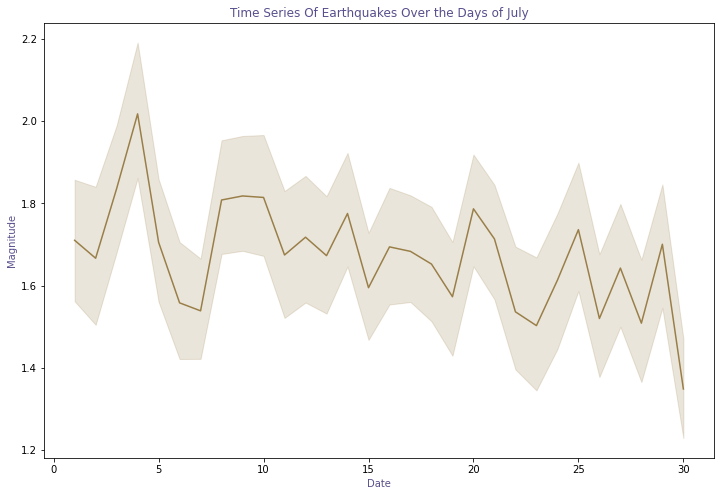

In [47]:
# Let's look at magnitudes of earthquakes over time.
# plotting a lineplot with magnitudes with respect to dates
plt.figure(figsize=(12,8))
# We should change this to .year instead when we have the full data
Time_series = sns.lineplot(x=df["Time"].dt.day,y="mag",data=df, color="#997e48")
Time_series.set_title("Average Earthquakes Over the Days of July", color="#58508d")
Time_series.set_ylabel("Magnitude", color="#58508d")
Time_series.set_xlabel("Date", color="#58508d")

In [ ]:
# Time between massive earthquakes, time series stuff
# get mag cutoff, have the time, have in order of time, calculate the delta between each row.
# show stuff about when reporting agencies developed and what countries are being reported vs which ones aren't.

In [30]:
tectonic_plates = pd.read_csv("tectonic_plate_boundaries.csv" )

In [31]:
tectonic_plates

,plate,lat,lon
0,am,30.754,132.824
1,am,30.970,132.965
2,am,31.216,133.197
3,am,31.515,133.500
4,am,31.882,134.042
...,...,...,...
12316,yz,19.713,113.274
12317,yz,19.288,113.517
12318,yz,18.863,113.759
12319,yz,18.438,114.000


In [33]:
#Ploting the tectonic plate's boundaries 
tectonic = folium.Map(tiles="cartodbpositron", zoom_start=5)

plates = list(tectonic_plates["plate"].unique())
for plate in plates:
    plate_vals = tectonic_plates[tectonic_plates["plate"] == plate]
    lats = plate_vals["lat"].values
    lons = plate_vals["lon"].values
    points = list(zip(lats, lons))
    indexes = [None] + [i + 1 for i, x in enumerate(points) if i < len(points) - 1 and abs(x[1] - points[i + 1][1]) > 300] + [None]
    for i in range(len(indexes) - 1):
        folium.vector_layers.PolyLine(points[indexes[i]:indexes[i+1]], popup=plate, color="#58508d", fill=False, ).add_to(tectonic)

tectonic

In [37]:
#Plottong the plates along with the earthquake
tectonic_quake = folium.Map(tiles="cartodbpositron", zoom_start=5)
gradient = {.33: "#7a5195", .66: "#ef5675", 1: "#ffa600"} 
plates = list(tectonic_plates["plate"].unique())
for plate in plates:
    plate_vals = tectonic_plates[tectonic_plates["plate"] == plate]
    lats = plate_vals["lat"].values
    lons = plate_vals["lon"].values
    points = list(zip(lats, lons))
    indexes = [None] + [i + 1 for i, x in enumerate(points) if i < len(points) - 1 and abs(x[1] - points[i + 1][1]) > 300] + [None]
    for i in range(len(indexes) - 1):
        folium.vector_layers.PolyLine(points[indexes[i]:indexes[i+1]], popup=plate, fill=False,  color="#58508d").add_to(tectonic_quake)
        HeatMap(data=df[["Latitude", "Longitude"]],hue="mag",min_opacity=0.5,radius=1,gradient=gradient).add_to(tectonic_quake)
tectonic_quake

In [44]:
# Create a base map with plate boundaries and deapth 
Mag_tectonics  = folium.Map(tiles="cartodbpositron", zoom_start=5)
gradient = {.33: "#628d82", .66: "#a3c5bf", 1: "#eafffd"} 
plates = list(tectonic_plates["plate"].unique())
for plate in plates:
    plate_vals = tectonic_plates[tectonic_plates["plate"] == plate]
    lats = plate_vals["lat"].values
    lons = plate_vals["lon"].values
    points = list(zip(lats, lons))
    indexes = [None] + [i + 1 for i, x in enumerate(points) if i < len(points) - 1 and abs(x[1] - points[i + 1][1]) > 300] + [None]
    for i in range(len(indexes) - 1):
        folium.vector_layers.PolyLine(points[indexes[i]:indexes[i+1]], fill=False,  color="#58508d").add_to(Mag_tectonics)
        
def colormag(val):
            if val < 5.9:
                return "#ffcf6a"
            elif val < 6.5:
                return "#fb8270"
            else:
                return "#bc5090"
            
for i in range(0,len(df)):
    folium.Circle(location=[df.iloc[i]["Latitude"], df.iloc[i]["Longitude"]],radius=2000, color=colormag(df.iloc[i]["mag"])).add_to(Mag_tectonics)
    
from branca.element import Template, MacroElement

template = """
{% macro html(this, kwargs) %}

<!doctype html>
<html lang="en">
<head>
  <meta charset="utf-8">
  <meta name="viewport" content="width=device-width, initial-scale=1">
  <title>jQuery UI Draggable - Default functionality</title>
  <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

  <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
  <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>

</head>
<body>

 
<div id='maplegend' class='maplegend' 
    style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
     border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>
     
<div class='legend-title'>Magnitude Scale </div>
<div class='legend-scale'>
  <ul class='legend-labels'>
    <li><span style='background:#ffcf6a;opacity:1;'></span>values less than 5.9</li>
    <li><span style='background:#fb8270;opacity:1;'></span>values less than 6.5</li>
    <li><span style='background:#bc5090;opacity:1;'></span>values less than 6.5</li>

  </ul>
</div>
</div>

</body>
</html>

<style type='text/css'>
  .maplegend .legend-title {
    text-align: left;
    margin-bottom: 5px;
    font-weight: bold;
    font-size: 90%;
    }
  .maplegend .legend-scale ul {
    margin: 0;
    margin-bottom: 5px;
    padding: 0;
    float: left;
    list-style: none;
    }
  .maplegend .legend-scale ul li {
    font-size: 80%;
    list-style: none;
    margin-left: 0;
    line-height: 18px;
    margin-bottom: 2px;
    }
  .maplegend ul.legend-labels li span {
    display: block;
    float: left;
    height: 16px;
    width: 30px;
    margin-right: 5px;
    margin-left: 0;
    border: 1px solid #999;
    }
  .maplegend .legend-source {
    font-size: 80%;
    color: #777;
    clear: both;
    }
  .maplegend a {
    color: #777;
        }
</style>
{% endmacro %}"""

macro = MacroElement()
macro._template = Template(template)

Mag_tectonics.get_root().add_child(macro)

Mag_tectonics

In [49]:
# Create a base map with plate boundaries and deapth 
Depth_tectonics  = folium.Map(tiles="cartodbpositron", zoom_start=5)
gradient = {.33: "#628d82", .66: "#a3c5bf", 1: "#eafffd"} 
plates = list(tectonic_plates["plate"].unique())
for plate in plates:
    plate_vals = tectonic_plates[tectonic_plates["plate"] == plate]
    lats = plate_vals["lat"].values
    lons = plate_vals["lon"].values
    points = list(zip(lats, lons))
    indexes = [None] + [i + 1 for i, x in enumerate(points) if i < len(points) - 1 and abs(x[1] - points[i + 1][1]) > 300] + [None]
    for i in range(len(indexes) - 1):
        folium.vector_layers.PolyLine(points[indexes[i]:indexes[i+1]],fill=False,  color="#58508d").add_to(Depth_tectonics)
        
def colordepth(val):
            if val < 50:
                return "#ffcf6a"
            elif val < 100:
                return "#fb8270"
            else:
                return "#bc5090"
            
for i in range(0,len(df)):
    folium.Circle(location=[df.iloc[i]["Latitude"], df.iloc[i]["Longitude"]],radius=2000, color=colordepth(df.iloc[i]["Depth"])).add_to(Depth_tectonics)

#A bit of extra code to get legent 
from branca.element import Template, MacroElement

template = """
{% macro html(this, kwargs) %}

<!doctype html>
<html lang="en">
<head>
  <meta charset="utf-8">
  <meta name="viewport" content="width=device-width, initial-scale=1">
  <title>jQuery UI Draggable - Default functionality</title>
  <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

  <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
  <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>

</head>
<body>

 
<div id='maplegend' class='maplegend' 
    style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
     border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>
     
<div class='legend-title'>Depth Scale </div>
<div class='legend-scale'>
  <ul class='legend-labels'>
    <li><span style='background:#ffcf6a;opacity:1;'></span>Depth less than 50</li>
    <li><span style='background:#fb8270;opacity:1;'></span>Depth less than 100</li>
    <li><span style='background:#bc5090;opacity:1;'></span>Depth more than 100</li>

  </ul>
</div>
</div>
 
</body>
</html>

<style type='text/css'>
  .maplegend .legend-title {
    text-align: left;
    margin-bottom: 5px;
    font-weight: bold;
    font-size: 90%;
    }
  .maplegend .legend-scale ul {
    margin: 0;
    margin-bottom: 5px;
    padding: 0;
    float: left;
    list-style: none;
    }
  .maplegend .legend-scale ul li {
    font-size: 80%;
    list-style: none;
    margin-left: 0;
    line-height: 18px;
    margin-bottom: 2px;
    }
  .maplegend ul.legend-labels li span {
    display: block;
    float: left;
    height: 16px;
    width: 30px;
    margin-right: 5px;
    margin-left: 0;
    border: 1px solid #999;
    }
  .maplegend .legend-source {
    font-size: 80%;
    color: #777;
    clear: both;
    }
  .maplegend a {
    color: #777;
    }
</style>
{% endmacro %}"""

macro = MacroElement()
macro._template = Template(template)

Depth_tectonics.get_root().add_child(macro)

Depth_tectonics
